# Object Detection: A Comparative Study of YOLOv8 and YOLO NAS on the TACO Dataset

## Evaluating the Efficacy of Leading Models on Real-World Data

**Author:** David Vikstrand  
**Field:** Computer Vision, Object Detection

---

## Introduction

Welcome to an in-depth exploration into the realm of object detection. In this study, we focus on two cutting-edge models—YOLOv8 and YOLO NAS—and evaluate their performance on the TACO (Trash Annotations in Context) dataset.

### Why the TACO Dataset?

The TACO dataset presents a challenging environment, characterized by unbalanced classes, inconsistent labels, and incorrect annotations. It serves as an excellent testbed to evaluate the robustness of object detection models in real-world scenarios. For more information on the dataset, please refer to the [TACO Dataset on Roboflow Universe](https://universe.roboflow.com/divya-lzcld/taco-mqclx/health).

### Objectives

1. **Understanding the TACO Dataset**: A comprehensive analysis to understand the dataset's intricacies.
  
2. **Exploratory Data Analysis (EDA)**: A deep dive into the dataset to identify its strengths and weaknesses.
  
3. **Data Cleaning and Refinement**: Preparing the dataset for optimal performance in our experiments.
  
4. **YOLOv8 vs YOLO NAS**: A head-to-head comparison to evaluate the performance of each model.
  
5. **Conclusions and Future Directions**: Final thoughts and potential avenues for further research.



## Training Time: A Race Against the Clock 

In this study, both YOLOv8 and YOLO NAS models will undergo training for a fixed duration of **6 hours** each.
The training is conducted on an A100-80G GPU, provided by [Paperspace Gradient](https://docs.paperspace.com/gradient/).

##### Why 6 Hours? 

**Time Constraints**: Paperspace Gradient's rental policy for the A100-80G GPU limits usage to 6-hour blocks. This constraint necessitates that the training duration for each model be capped at 6 hours.

By adhering to this 6-hour window, we aim to create a level playing field for both models, ensuring that the comparison is as fair as possible given the hardware and time restrictions. This also adds an extra layer of challenge, pushing us to optimize each model's performance within a constrained timeframe. 🕒

---

## Results

### Performance Metrics

#### YOLOv8
- **Precision**: 0.75452
- **Recall**: 0.51041
- **mAP@0.50**: 0.58312
- **mAP@0.50-0.95**: 0.47692

#### YOLO NAS
- **Precision**: 0.15560
- **Recall**: 0.66646
- **mAP@0.50**: 0.56624
- **F1 Score**: 0.25143

### Observations

YOLOv8 outperformed YOLO NAS in terms of precision and mAP scores. However, it's crucial to note that YOLOv8 underwent more test runs, allowing for better parameter tuning. On the other hand, YOLO NAS has more parameters that have yet to be optimized, including its loss function.

### Considerations

While YOLOv8 emerged as the stronger performer in this experiment, the results should be interpreted with caution. The untapped potential of YOLO NAS suggests that further tuning could yield different outcomes.

### Future Directions

Given the complexity and the number of parameters in YOLO NAS, future work could focus on fine-tuning these aspects to potentially improve its performance.

---

This study aims to be more than just a technical evaluation; it's a journey through the challenges and opportunities in the field of object detection. The goal is not perfection but continuous growth and understanding. 

# Libraries and Dependencies 

In [ ]:
!pip install super-gradients==3.2.1 -q

**Note:** After installing super-gradients, you'll need to restart the runtime.

In [ ]:
from super_gradients.training import Trainer, models
from super_gradients.training.dataloaders.dataloaders import (
    coco_detection_yolo_format_train,
    coco_detection_yolo_format_val,
)

from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import (
    PPYoloEPostPredictionCallback,
)

In [ ]:
!pip install  supervision -q
!pip install --upgrade pillow -q
!pip install jupyter_black -q
!pip install ultralytics -q
!pip install albumentations  -q
!pip install --upgrade torch -q
!pip install --upgrade torchvision -q
!pip install  supervision -q
!pip install --upgrade pillow -q

In [ ]:
import os
import random
import cv2
import yaml
import shutil
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import pandas as pd
from pprint import pprint
from typing import List, ContextManager

%matplotlib inline

from collections import defaultdict

import jupyter_black

jupyter_black.load()

import ultralytics

import supervision as sv

from ultralytics import YOLO

from contextlib import contextmanager


ultralytics.checks()

  Successfully uninstalled wandb-0.13.4


Ultralytics YOLOv8.0.190 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA A100-SXM4-80GB, 81229MiB)
Setup complete ✅ (12 CPUs, 88.4 GB RAM, 139.1/244.2 GB disk)


### Downloading the Dataset

In [ ]:
!pip install roboflow -q

from roboflow import Roboflow

rf = Roboflow(api_key="your_api_key_here")
project = rf.workspace("divya-lzcld").project("taco-mqclx")
dataset = project.version(3).download("yolov8")

#  Constants and Utility Functions 







In [4]:
DATA = "/notebooks/TACO-3"

TRAIN_IMAGES = "train/images"
TRAIN_LABELS = "train/labels"

VAL_IMAGES = "valid/images"
VAL_LABELS = "valid/labels"

TEST_IMAGES = "test/images"
TEST_LABELS = "test/labels"

LABEL_DICT = {"train": TRAIN_LABELS, "valid": VAL_LABELS, "test": TEST_LABELS}
IMAGES_DICT = {"train": TRAIN_IMAGES, "valid": VAL_IMAGES, "test": TEST_IMAGES}

YAML_PATH = "/notebooks/TACO-3/data.yaml"

In [56]:
def plot_result(df: pd.DataFrame) -> None:
    """
    Plot the training results of the YOLOv8 model.

    Parameters:
    - df (pd.DataFrame): DataFrame containing the training metrics.
    """
    fig, axes = plt.subplots(
        nrows=(len(df.columns) + 2) // 3, ncols=3, figsize=(20, 15)
    )
    axes = axes.flatten()

    for i, col in enumerate(df.columns):
        axes[i].plot(df[col])
        axes[i].set_title(col)
        axes[i].set_xlabel("Epoch")
        axes[i].set_ylabel("Value")

    for i in range(len(df.columns), len(axes)):
        fig.delaxes(axes[i])

    fig.suptitle("YOLOv8 Training Results", fontsize=50, fontweight="bold", y=1.02)
    plt.tight_layout()
    plt.show()


def get_latest_folder(folder_path: str, prefix: str) -> str:
    """
    Get the latest folder in a directory with a specific prefix.

    Parameters:
    - folder_path (str): The path to the directory.
    - prefix (str): The prefix of the folder names.

    Returns:
    - str: The path to the latest folder.
    """
    highest_number = 0
    highest_folder_index_path = ""

    for subfolder_name in os.listdir(folder_path):
        full_path = os.path.join(folder_path, subfolder_name)

        if os.path.isdir(full_path) and subfolder_name.startswith(prefix):
            suffix = subfolder_name[len(prefix) :]

            if suffix.isdigit():
                folder_number = int(suffix)

                if folder_number > highest_number:
                    highest_number = folder_number
                    highest_folder_index_path = full_path
            elif not highest_folder_index_path:
                highest_folder_index_path = full_path

    return highest_folder_index_path

def count_files_in_directory(directory: str) -> int:
    """
    Count the number of JPEG files in a directory.

    Parameters:
    - directory (str): The path to the directory.

    Returns:
    - int: The number of JPEG files.
    """
    return len([f for f in os.listdir(directory) if f.endswith(".jpg")])


def get_label_files(data_type: str) -> List[str]:
    """
    Get all label files of a specific data type.

    Parameters:
    - data_type (str): The type of data (e.g., 'train', 'test').

    Returns:
    - List[str]: List of label files.
    """
    label_dir = os.path.join(DATA, LABEL_DICT[data_type])
    return [f for f in os.listdir(label_dir) if f.endswith(".txt")]


def get_boxes_from_label_file(label_dir: str, label_file: str) -> List[List[float]]:
    """
    Get bounding boxes from a label file.

    Parameters:
    - label_dir (str): The directory containing the label file.
    - label_file (str): The name of the label file.

    Returns:
    - List[List[float]]: List of bounding boxes.
    """
    with open(os.path.join(DATA, label_dir, label_file), "r") as f:
        return [list(map(float, box.strip().split())) for box in f.readlines()]



@contextmanager
def set_seed(n: int = 420) -> ContextManager[None]:
    """
    Temporarily set the random seed.

    Parameters:
    - n (int): The seed value.

    Yields:
    - None
    """
    random.seed(n)
    yield
    random.seed(None)

In [7]:
with open(YAML_PATH, "r") as stream:
    # Parse the YAML content
    yaml_content = yaml.safe_load(stream)

    # Extract the class names
    class_labels = yaml_content.get("names", [])

print("Class Names:", class_labels)

Class Names: ['Aluminium foil', 'Bottle cap', 'Bottle', 'Broken glass', 'Can', 'Carton', 'Cigarette', 'Cup', 'Lid', 'Other litter', 'Other plastic', 'Paper', 'Plastic bag - wrapper', 'Plastic container', 'Pop tab', 'Straw', 'Styrofoam piece', 'Unlabeled litter']


#  Exploring TACO Dataset

### Data Splitting Strategy: A Balanced Approach 

One of the key steps in this project is to split the TACO dataset into training, testing, and validation sets. The aim is to achieve a balanced distribution with the following proportions:

- **Training Set**: 70% of the data
- **Testing Set**: 15% of the data
- **Validation Set**: 15% of the data



In [50]:
def plot_data_distribution():
    train_count = count_files_in_directory(os.path.join(DATA, TRAIN_IMAGES))
    val_count = count_files_in_directory(os.path.join(DATA, VAL_IMAGES))
    test_count = count_files_in_directory(os.path.join(DATA, TEST_IMAGES))

    labels = [
        f"Train ({train_count})",
        f"Validation ({val_count})",
        f"Test ({test_count})",
    ]
    sizes = [train_count, val_count, test_count]
    colors = ["gold", "yellowgreen", "lightcoral"]
    explode = (0.1, 0, 0)

    plt.figure(figsize=(10, 6))
    plt.pie(
        sizes,
        explode=explode,
        labels=labels,
        colors=colors,
        autopct="%1.1f%%",
        shadow=True,
        startangle=140,
    )

    plt.axis("equal")
    plt.title("Data Distribution", fontsize=20, pad=20)
    plt.legend(title="Data Sets")
    plt.show()
    
    return train_count, val_count, test_count

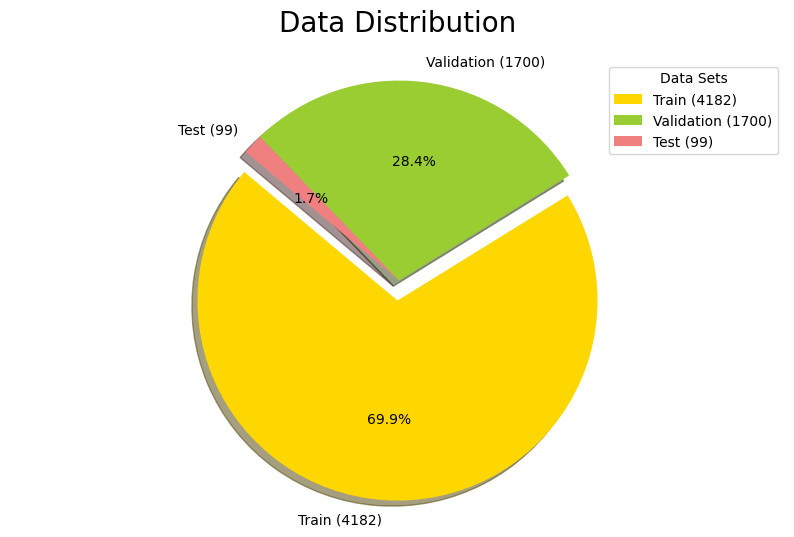

In [33]:
train_count, val_count, test_count = plot_data_distribution()

In [44]:
total_images = train_count + val_count + test_count
print(f"Total images: {total_images}")

train_percent = 0.7
val_percent = 0.15
test_percent = 0.15

new_train_count = int(total_images * train_percent)
new_val_count = int(total_images * val_percent)
new_test_count = int(total_images * test_percent)

print(f"New train count: {new_train_count}")
print(f"New validation count: {new_val_count}")
print(f"New test count: {new_test_count}")

Total images: 5981
New train count: 4186
New validation count: 897
New test count: 897


In [48]:
def move_images_and_labels(data_type, num_to_move):
    src_images = os.path.join(DATA, IMAGES_DICT[data_type])
    src_labels = os.path.join(DATA, LABEL_DICT[data_type])

    dest_images = os.path.join(DATA, IMAGES_DICT["test"])
    dest_labels = os.path.join(DATA, LABEL_DICT["test"])

    src_image_files = [f for f in os.listdir(src_images) if f.endswith(".jpg")]
    for img_name in random.sample(src_image_files, num_to_move):
        label_name = img_name.replace(".jpg", ".txt")
        shutil.move(
            os.path.join(src_images, img_name), os.path.join(dest_images, img_name)
        )
        shutil.move(
            os.path.join(src_labels, label_name), os.path.join(dest_labels, label_name)
        )

In [49]:
val_to_move = val_count - new_val_count
move_images_and_labels("valid", val_to_move)

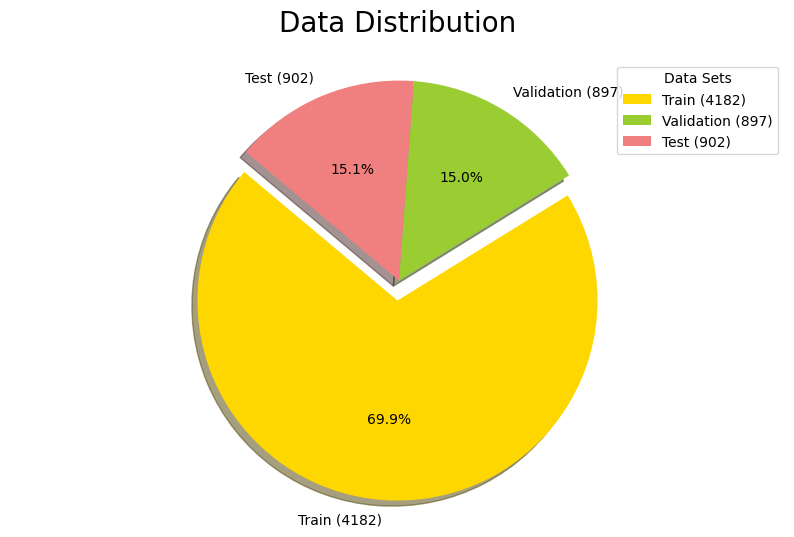

In [51]:
plot_data_distribution()

## Data Aggregation: Tackling Class Imbalance 

The TACO dataset presents a significant class imbalance, with some classes being over-represented and others under-represented. Additionally, certain classes like "Unlabeled litter" are ambiguous and potentially overlap with other categories. 

#### Initial Class Distribution 

- **Over Represented**: Plastic bag & wrapper, Cigarette, Unlabeled litter, etc.
- **Under Represented**: Broken glass, Paper, Straw, etc.

#### Aggregation Strategy 

To address these issues, the following steps were taken:

1. **Merging Similar Classes**: Classes that are closely related, such as "Carton" and "Styrofoam," were merged into a single class called "Carton & Styrofoam."

2. **Removing and Merging Ambiguous Classes**: The "Unlabeled litter" class was removed due to its ambiguity. Lower-represented classes were merged into the "Other litter" class, which was already diverse and over-represented.

3. **Focusing on Key Classes**: Given the imbalance and the project's scope, the focus was narrowed down to the following classes:

4. **Aiming for Class Balance**: The final selection of classes was also influenced by the desire to keep the new classes as balanced as possible in terms of representation. This ensures a more equitable distribution of data across classes, facilitating more robust model training and evaluation.

    - Cigarette
    - Plastic bag - wrapper
    - Bottle
    - Other litter
    - Cup
    - Can
    - Carton & Styrofoam

By applying this aggregation strategy, the aim is to create a more balanced dataset that still captures the essence of the litter problem. This refined class structure allows for more meaningful training and evaluation of the object detection models.



In [ ]:
def display_images(
    selected_images,
    num_display,
    plot_title,
    image_dir=TRAIN_IMAGES,
    label_dir=TRAIN_LABELS,
):
    label_dir = os.path.join(DATA, label_dir)
    image_path = os.path.join(DATA, image_dir)

    plt.figure(figsize=(12, 12))
    for i, label_name in enumerate(selected_images):
        image_name = label_name.replace(".txt", ".jpg")
        img_path = os.path.join(image_path, image_name)
        label_path = os.path.join(label_dir, label_name)

        # Read image
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w, _ = img.shape

        # Read label file and get bounding boxes
        with open(label_path, "r") as f:
            lines = f.readlines()

        # Plot image
        ax = plt.subplot(num_display, num_display, i + 1)
        plt.imshow(img)
        plt.axis("off")

        # Plot bounding boxes
        for line in lines:
            _, x_center, y_center, width, height = map(float, line.strip().split())
            x1 = int((x_center - width / 2) * w)
            y1 = int((y_center - height / 2) * h)
            box_width = int(width * w)
            box_height = int(height * h)

            rect = patches.Rectangle(
                (x1, y1),
                box_width,
                box_height,
                linewidth=1,
                edgecolor="r",
                facecolor="none",
            )
            ax.add_patch(rect)

    # plot config
    plt.tight_layout()
    plt.suptitle(
        plot_title,
        fontsize=30,
        y=1.05,
        fontweight="bold",
    )
    plt.show()

In [40]:
def display_images_for_class(class_id, data_type, class_labels, num_images=3):
    """
    Display images for a given class ID in a 3x3 grid.
    """
    label_files = get_label_files(data_type)
    label_list = []

    for label_file in label_files:
        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        with open(label_path, "r") as f:
            for line in f:
                if int((line.split()[0])) == class_id:
                    label_list.append(label_file)
                    break

    selected_images = random.sample(label_list, num_images * num_images)

    plot_title = f"Displaying images containing class: {class_labels[class_id]}"
    display_images(selected_images, num_images, plot_title)

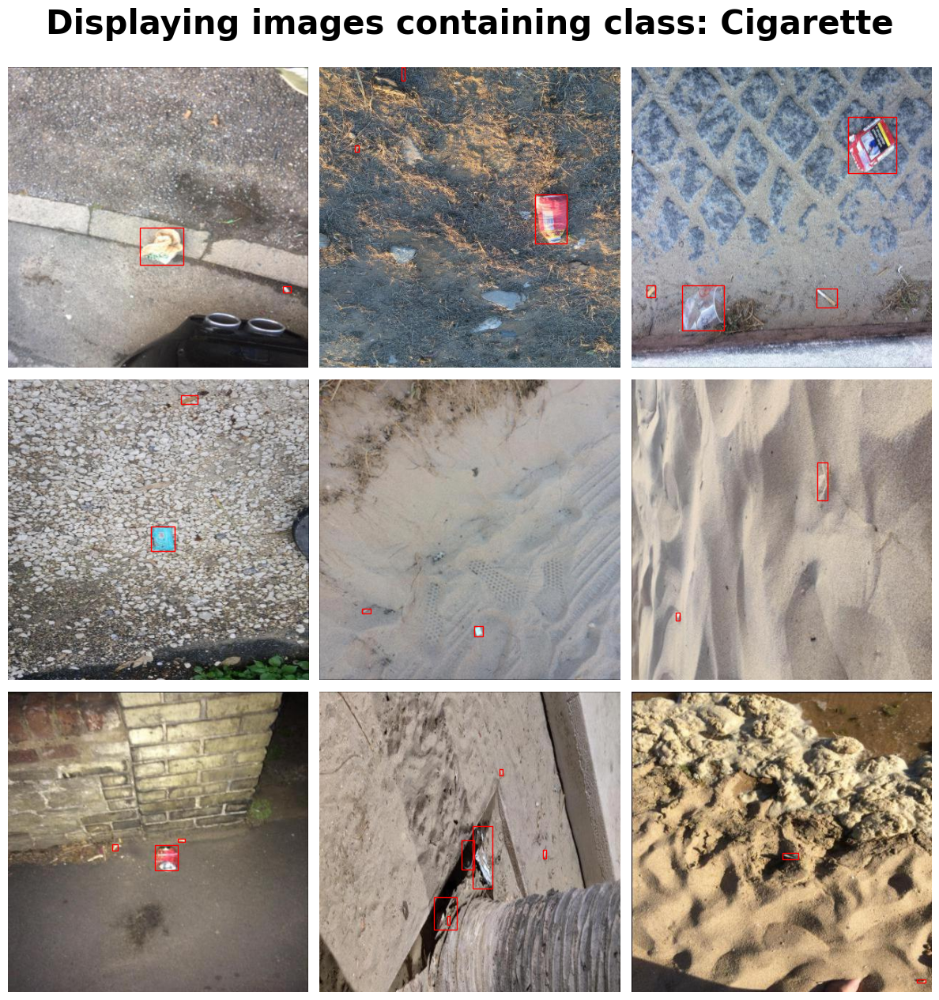

In [68]:
display_images_for_class(0, "train", class_labels)

After examining the classes, I found this to be the best way to agregate them

In [24]:
# map new class IDs to class titles

class_labels_grouped = [
    (3, "Aluminium foil"),
    (2, "Bottle cap"),
    (2, "Bottle"),
    (2, "Broken glass"),
    (5, "Can"),
    (6, "Carton"),
    (0, "Cigarette"),
    (4, "Cup"),
    (4, "Lid"),
    (3, "Other litter"),
    (3, "Other plastic"),
    (1, "Paper"),
    (1, "Plastic bag - wrapper"),
    (3, "Plastic container"),
    (5, "Pop tab"),
    (3, "Straw"),
    (6, "Styrofoam piece"),
    (3, "Unlabeled litter"),
]

In [25]:
def group_labels(data_type, class_labels=class_labels, class_grouped=class_labels_grouped):
    """Group class IDs in label files according to the mapping defined above."""
    # map class titles to class IDs
    rev_class_labels = {v: k for k, v in class_labels.items()}

    # map old class IDs to new class IDs
    old_to_new_map = {rev_class_labels[v]: k for k, v in class_grouped}

    label_dir = os.path.join(DATA, LABEL_DICT[data_type])
    for label_file in os.listdir(label_dir):
        if not label_file.endswith(".txt"):
            continue

        new_lines = []
        with open(os.path.join(label_dir, label_file), "r") as lines:
            for line in lines:
                parts = line.split()
                original_class_id = int(parts[0])
                new_class_id = old_to_new_map[original_class_id]
                new_line = f"{new_class_id} {' '.join(parts[1:])}\n"
                new_lines.append(new_line)

        with open(os.path.join(label_dir, label_file), "w") as f:
            f.writelines(new_lines)

    print(f"Grouped labels for {data_type} set")

In [95]:
group_labels("train")
group_labels("test")
group_labels("valid")

Grouped labels for train set
Grouped labels for test set
Grouped labels for valid set


In [18]:
new_labels = [
    "Cigarette",
    "Plastic bag - wrapper",
    "Bottle",
    "Other litter",
    "Cup",
    "Can",
    "Carton & Styrofoam",
]

Updating the YAML file to reflect the new classes

In [27]:
def update_yaml(file_path, new_labels):
    # Read the existing YAML file
    with open(file_path, "r") as f:
        data = yaml.safe_load(f)

    # Update the 'names' section with new classes
    new_names = [new_labels[i] for i in range(len(new_labels))]

    data["names"] = new_names
    data["nc"] = len(new_names)

    with open(f"{file_path}", "w") as f:
        yaml.safe_dump(data, f)
    with open(f"{file_path}", "r") as f:
        print(f.read())

In [28]:
update_yaml(YAML_PATH, new_labels)

names:
- Cigarette
- Plastic bag - wrapper
- Bottle
- Other litter
- Cup
- Can
- Carton & Styrofoam
nc: 7
roboflow:
  license: CC BY 4.0
  project: taco-mqclx
  url: https://universe.roboflow.com/divya-lzcld/taco-mqclx/dataset/3
  version: 3
  workspace: divya-lzcld
test: ../test/images
train: ../train/images
val: ../valid/images



## Examinating the new class distribution

In [41]:
def new_class_dist(data_type):
    """Reads the distribution of classes in the dataset."""
    class_counts = defaultdict(int)
    label_files = get_label_files(data_type)

    # Loop through each label file to count classes
    for label_file in label_files:
        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        with open(label_path, "r") as bboxes:
            for box in bboxes:
                class_id = int(box.split()[0])
                class_counts[class_id] += 1

    return class_counts

In [29]:
def display_dist(label_count, data_type, new_labels=new_labels):
    """Displays the distribution of classes in the dataset."""
    class_names = [new_labels[idx] for idx in sorted(label_count.keys())]
    class_counts = [label_count[k] for k in sorted(label_count.keys())]

    plt.figure(figsize=(10, 5))
    plt.barh(class_names, class_counts, color="skyblue")
    plt.xlabel("Count")
    plt.ylabel("Class")
    plt.title(f"{data_type} Class Distribution")
    plt.show()

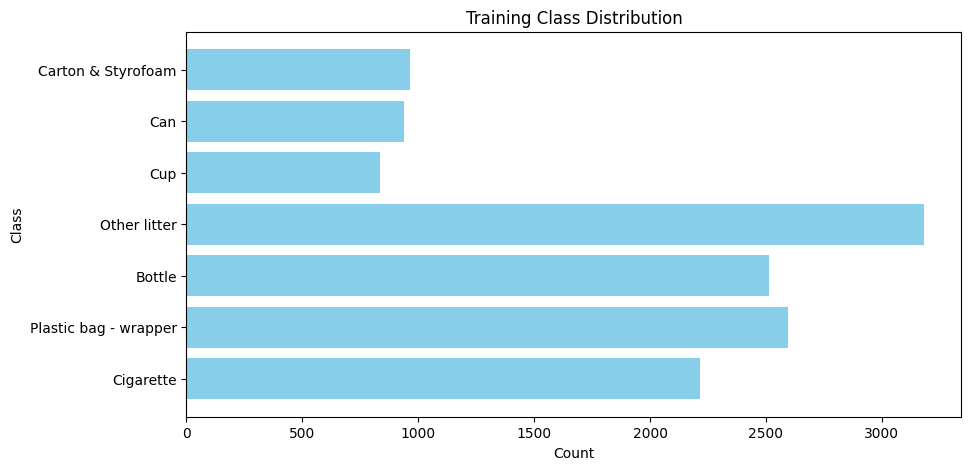

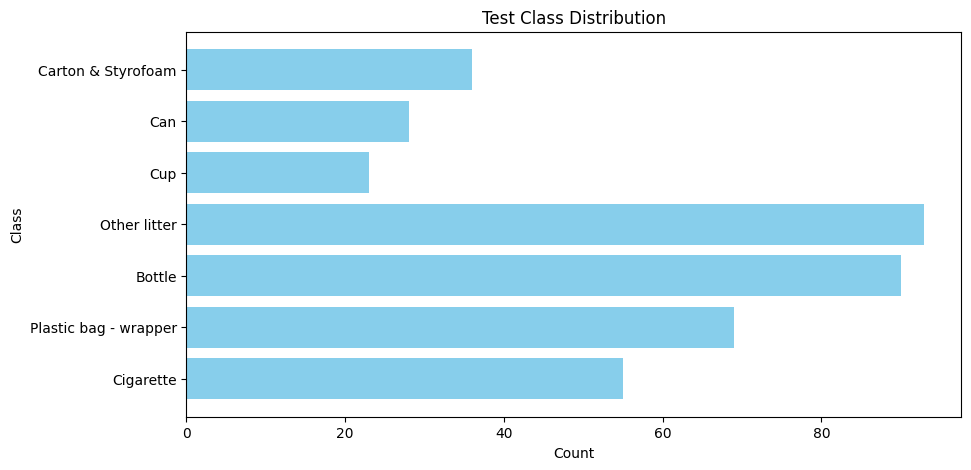

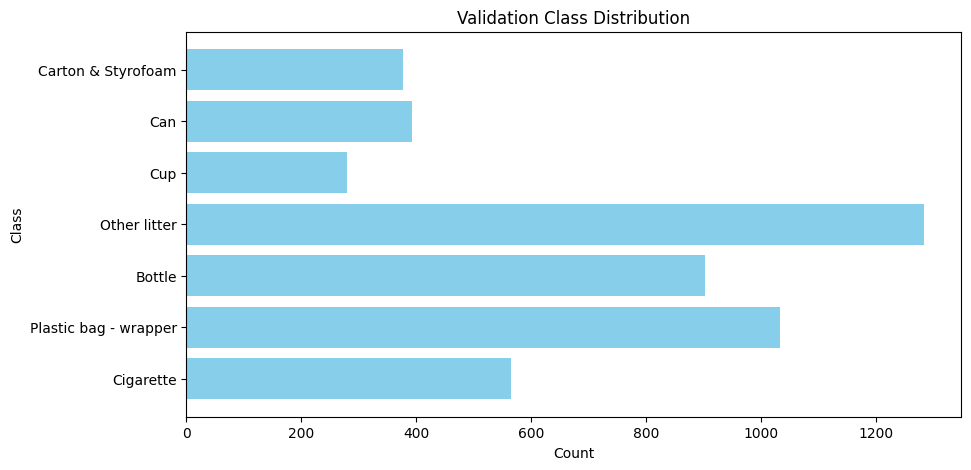

In [98]:
train_dist = new_class_dist("train")
test_dist = new_class_dist("test")
val_dist = new_class_dist("valid")

display_dist(train_dist, "Training")
display_dist(test_dist, "Test")
display_dist(val_dist, "Validation")

Even though the new classes are not perfectly balanced, they are much more balanced than before. Hopefully this will help the model to learn more effectively.

## Dealing with High Bounding Box Counts 

In addition to class balancing and aggregation, another crucial step in data preparation involved the removal of outliers. Specifically, images with an unusually high number of bounding boxes were identified as outliers.



In [46]:
def get_box_count_stats(data_type, box_count_treshold=10):
    avg_boxes_per_image = 0
    max_boxes_per_image = -1
    high_box_count_list = []

    label_files = get_label_files(data_type)
    for label_file in label_files:
        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        with open(label_path, "r") as f:
            boxes = f.readlines()
            avg_boxes_per_image += len(boxes)
            max_boxes_per_image = max(max_boxes_per_image, len(boxes))

            if len(boxes) >= box_count_treshold:
                high_box_count_list.append((len(boxes), (label_file)))

    avg_boxes_per_image /= len(label_files)
    print(
        data_type.capitalize(),
        f"\nAverage boxes per image for {data_type} set: {avg_boxes_per_image}",
        f"\nMaximum boxes per image for {data_type} set: {max_boxes_per_image}\n",
    )

    return sorted(high_box_count_list, key=lambda x: x[0], reverse=True)

In [100]:
high_box_count_train = get_box_count_stats("train", box_count_treshold=10)
high_box_count_test = get_box_count_stats("test", box_count_treshold=10)
high_box_count_val = get_box_count_stats("valid", box_count_treshold=10)

Train 
Average boxes per image for train set: 3.1547619047619047 
Maximum boxes per image for train set: 90

Test 
Average boxes per image for test set: 3.94 
Maximum boxes per image for test set: 54

Valid 
Average boxes per image for valid set: 2.834507042253521 
Maximum boxes per image for valid set: 90



In [105]:
def display_high_box_count_images(num_boxes_lim, data_type, box_count, num_display=6):
    n = box_count[0][0]
    start = 0

    # Get the start and end indices for the images to be displayed
    display_size = num_display * num_display
    while n > num_boxes_lim and start + 1 < len(box_count):
        start += 1
        n = box_count[start][0]
    end = start + display_size

    # If the end index is greater than the number of images, set it to the last image
    if end > len(box_count):
        end = len(box_count)
        start = end - display_size
        print(f"Showing last {end - start} images")

    selected_images = [label_name for _, label_name in box_count[start:end]]
    plot_title = f"Images with {num_boxes_lim} boxes in {data_type} set"
    display_images(selected_images, num_display, plot_title)

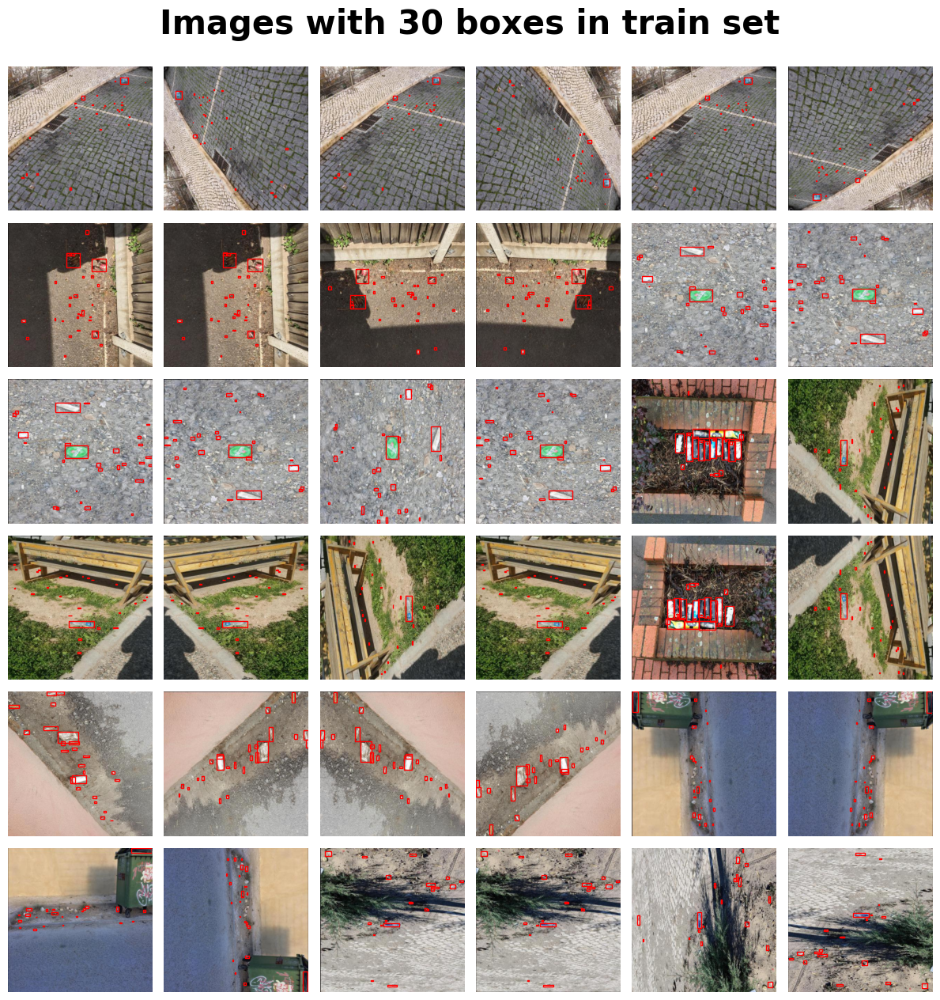

In [106]:
display_high_box_count_images(30, "train", high_box_count_train)

After examining the images, I found that the images with more than 30 bounding boxes were too noisy and would likely cause problems for the model. I decided to remove them from the dataset. This ended up removing 18 images from training, 1 from testing, and 4 from validation.

In [107]:
def discard_images_with_high_box_count(data_type, box_count_list, bbox_threshold):
    label_dir = os.path.join(DATA, LABEL_DICT[data_type])
    image_dir = os.path.join(DATA, IMAGES_DICT[data_type])
    discard_count = 0
    
    for num_boxes, label_name in box_count_list:
        if num_boxes <= bbox_threshold:
            break
        image_name = label_name.replace(".txt", ".jpg")
        img_path = os.path.join(image_dir, image_name)
        label_path = os.path.join(label_dir, label_name)
        os.remove(img_path)
        os.remove(label_path)
        discard_count += 1

    print(f"Discarded {discard_count} images")

In [108]:
discard_images_with_high_box_count("train", high_box_count_train, 30)
discard_images_with_high_box_count("test", high_box_count_test, 30)
discard_images_with_high_box_count("valid", high_box_count_val, 30)

Discarded 18 images
Discarded 1 images
Discarded 4 images


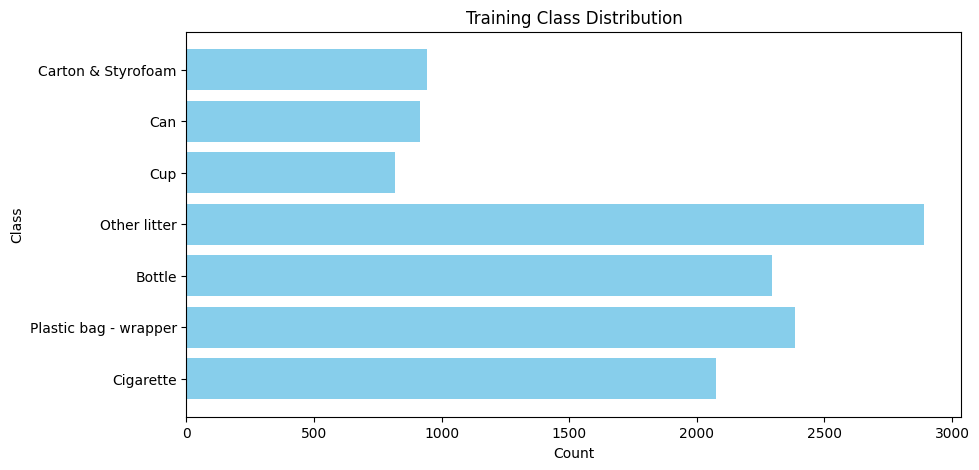

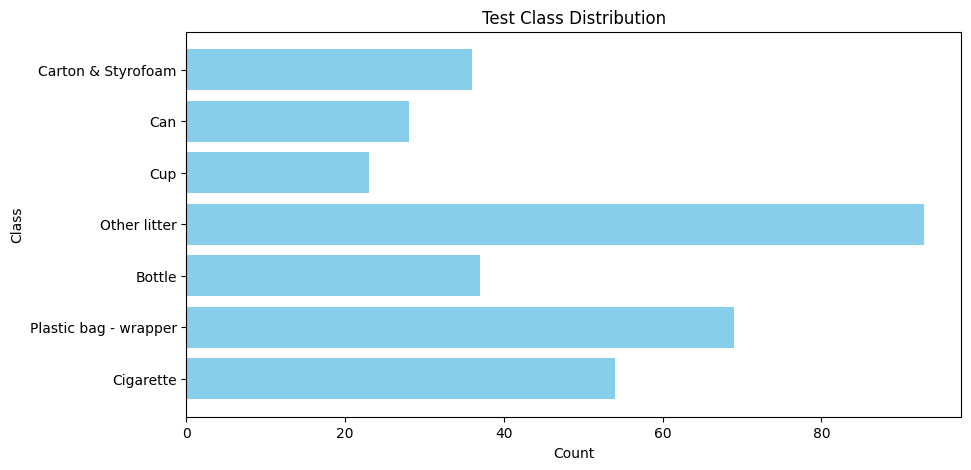

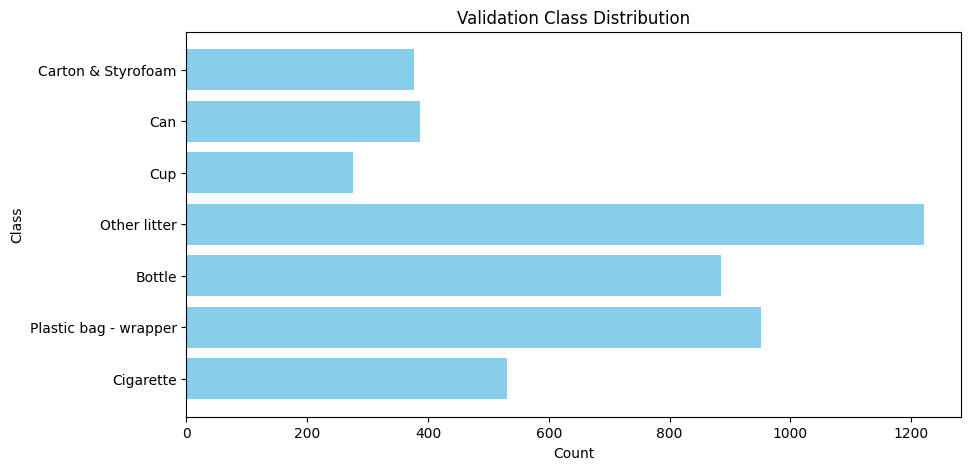

In [109]:
cleaned_train_dist = new_class_dist("train")
cleaned_test_dist = new_class_dist("test")
cleaned_val_dist = new_class_dist("valid")

display_dist(cleaned_train_dist, "Training")
display_dist(cleaned_test_dist, "Test")
display_dist(cleaned_val_dist, "Validation")

In [110]:
high_box_count_train = get_box_count_stats("train", box_count_treshold=10)
high_box_count_test = get_box_count_stats("test", box_count_treshold=10)
high_box_count_val = get_box_count_stats("valid", box_count_treshold=10)

Train 
Average boxes per image for train set: 2.9457197513151603 
Maximum boxes per image for train set: 30

Test 
Average boxes per image for test set: 3.4343434343434343 
Maximum boxes per image for test set: 25

Valid 
Average boxes per image for valid set: 2.721764705882353 
Maximum boxes per image for valid set: 28



## Fine-Tuning Bounding Box Sizes: The Case of Tiny Boxes 📏

Another layer of data refinement involved examining the sizes of bounding boxes across all classes. It was observed that very small bounding boxes could potentially harm the model's performance.

#### The Cigarette Class: A Case Study 🚬

The "Cigarette" class was particularly affected, featuring numerous instances of extremely small bounding boxes.

#### Why Remove Small Bounding Boxes? 🤔

1. **Data Quality**: Tiny bounding boxes can be less informative and may introduce noise into the dataset.
  
2. **Model Generalization**: Such anomalies can affect the model's ability to generalize well on new data.

3. **Computational Efficiency**: Processing these small bounding boxes can be computationally expensive and may slow down training.

#### The Size Threshold 🎯

After a thorough examination of the data, a size threshold of 0.00015 was established for bounding boxes. Any bounding box smaller than this was removed from the dataset.

By implementing this size threshold, the aim is to improve data quality and model performance, while also making the training process more efficient.



In [51]:
def get_box_size_stats(data_type):
    """Gets statistics about bounding box sizes and plots a histogram."""
    box_sizes = []
    total_boxes = 0
    avg_box_size = 0

    label_files = get_label_files(data_type)
    for label_file in label_files:
        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        with open(label_path, "r") as f:
            boxes = f.readlines()
            for box in boxes:
                *_, width, height = map(float, box.strip().split())
                box_size = width * height
                avg_box_size += box_size
                box_sizes.append(box_size)
                total_boxes += 1

    if total_boxes == 0:
        print("No boxes found.")
        return

    avg_box_size /= total_boxes
    print(
        data_type.capitalize(),
        f"\nAverage box size for {data_type} set: {avg_box_size}\n",
    )

    # Plotting the histogram
    plt.hist(box_sizes, bins=50, alpha=0.7, color="blue", edgecolor="black")
    plt.title(f"Distribution of Box Sizes in {data_type.capitalize()} Set")
    plt.xlabel("Box Size")
    plt.ylabel("Frequency")
    plt.show()

Train 
Average box size for train set: 0.03081652840338436



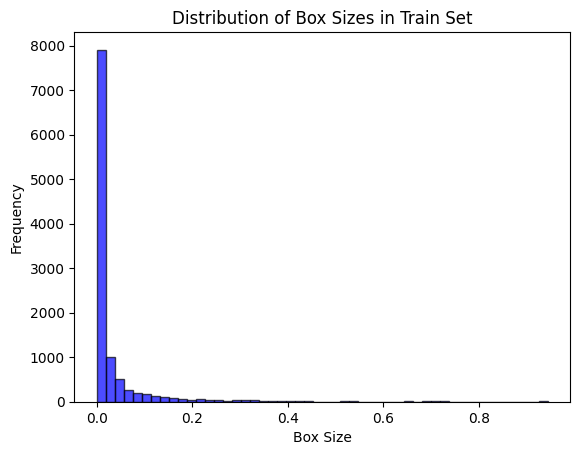

In [52]:
get_box_size_stats("train")

In [53]:
def get_average_box_size_per_class(data_type):
    """Analyzes and reports the average bounding box size for each class in the dataset."""

    class_box_sizes = defaultdict(int)
    class_box_count = defaultdict(int)
    label_files = get_label_files(data_type)

    for label_file in label_files:
        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        with open(label_path, "r") as boxes:
            for box in boxes:
                class_id, *_, width, height = map(float, box.strip().split())
                box_size = width * height
                class_box_sizes[class_id] += box_size
                class_box_count[class_id] += 1

    # Calculate average box size for each class
    avg_box_sizes = {
        new_labels[k]: v / class_box_count[k] for k, v in class_box_sizes.items()
    }

    # Plotting the horizontal bar chart
    plt.barh(list(avg_box_sizes.keys()), list(avg_box_sizes.values()), color="skyblue")
    plt.xlabel("Average Box Size")
    plt.ylabel("Class ID")
    plt.title(f"Average Box Size per Class in {data_type.capitalize()} Set")
    for i, v in enumerate(avg_box_sizes.values()):
        plt.text(v, i, f"{v:.4f}")

    plt.show()

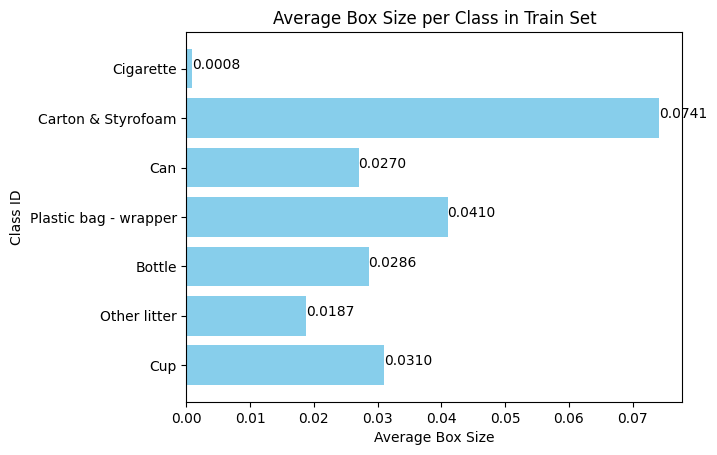

In [117]:
get_average_box_size_per_class("train")

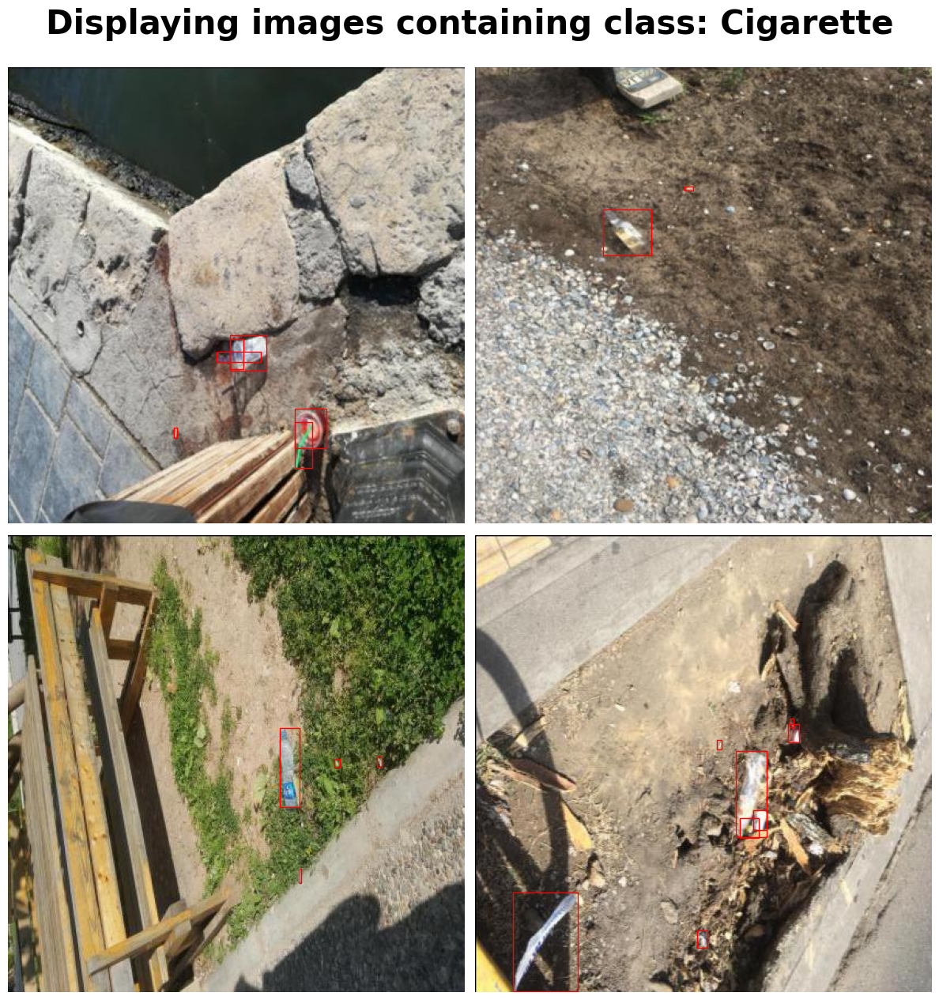

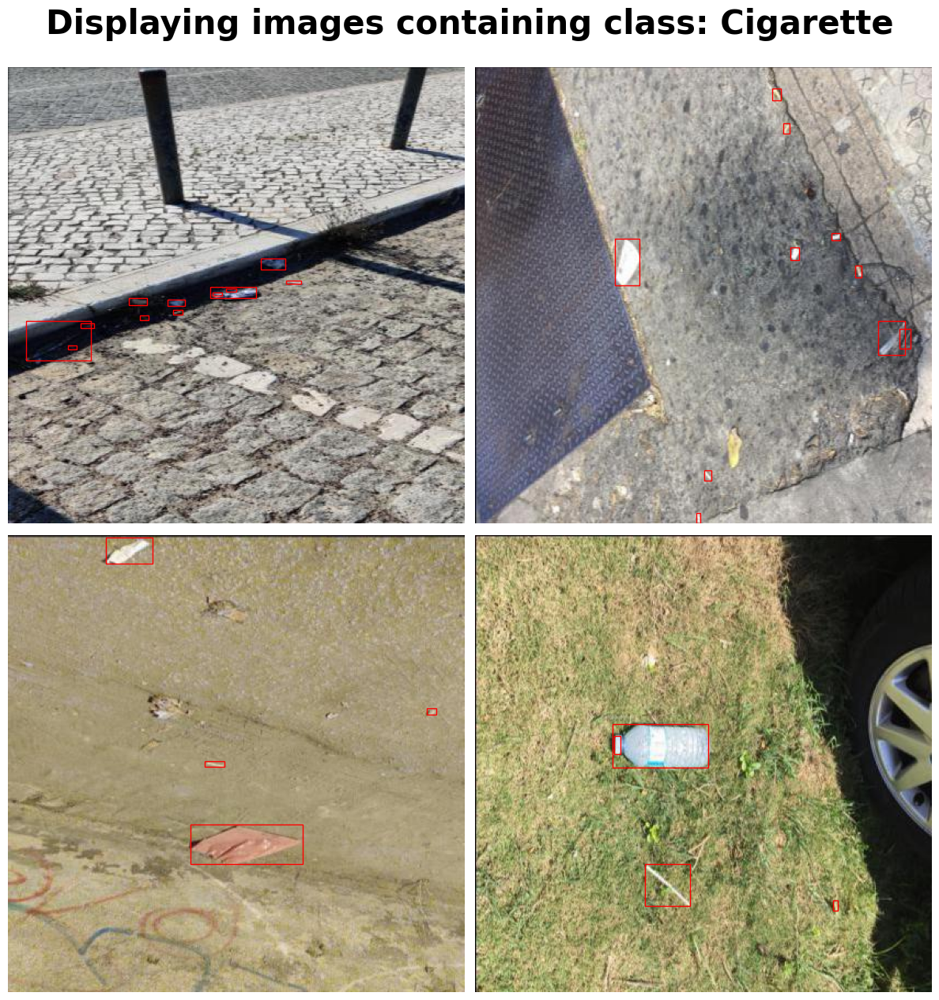

In [144]:
display_images_for_class(0, "train", new_labels, num_images=2)
display_images_for_class(0, "train", new_labels, num_images=2)

In [59]:
def count_small_boxes(data_type, size_threshold, label_map):
    """Removes bounding boxes smaller than the given size threshold."""
    class_count = defaultdict(int)

    label_files = get_label_files(data_type)
    for label_file in label_files:
        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        with open(label_path, "r") as lines:
            for line in lines:
                *_, width, height = map(float, line.strip().split())
                box_size = width * height
                if box_size < size_threshold:
                    class_count[label_map[int(line.split()[0])]] += 1

    if not class_count:
        print("No boxes found.")
        return
    
    pd.Series(class_count).plot.barh(figsize=(10, 5), color="skyblue")
    plt.xlabel("Count")
    plt.title(
        f"{data_type.capitalize()} bboxes below threshold: {size_threshold}",
        fontsize=15,
    )
    plt.show()

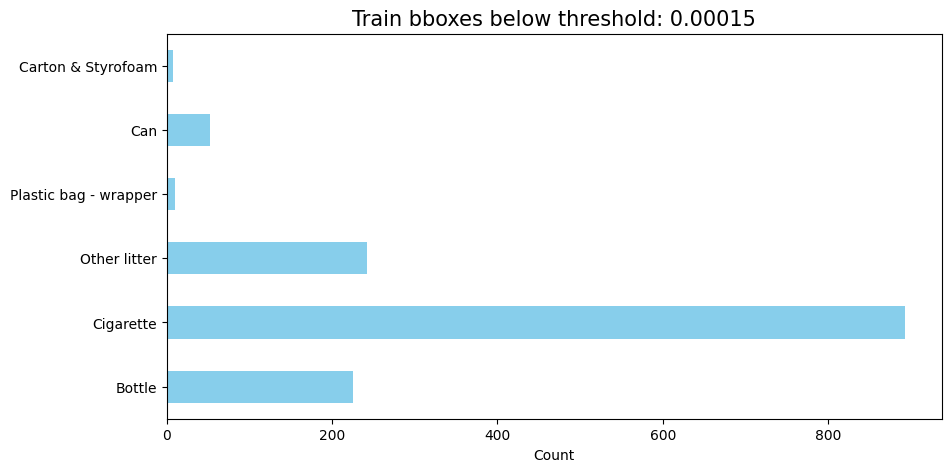

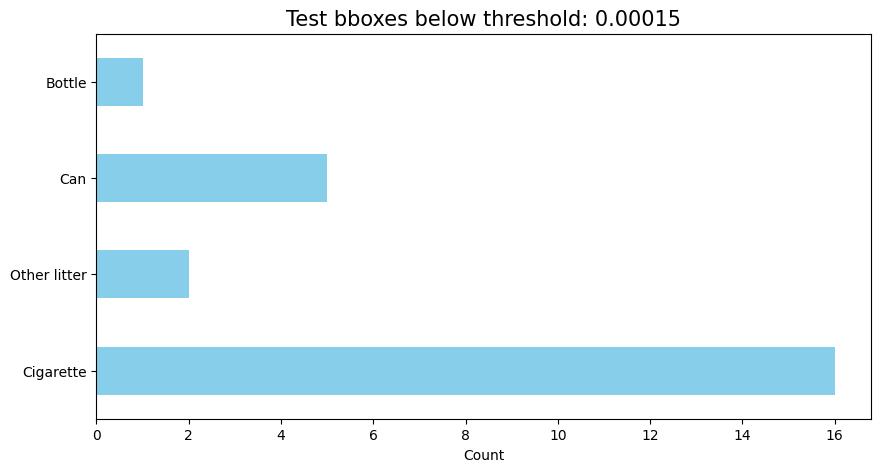

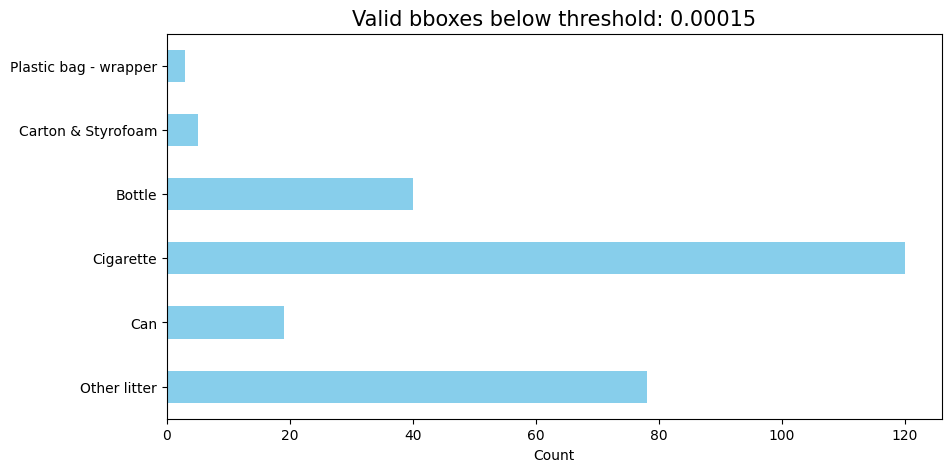

In [130]:
count_small_boxes("train", 0.00015, new_labels)
count_small_boxes("test", 0.00015, new_labels)
count_small_boxes("valid", 0.00015, new_labels)

In [61]:
def remove_small_boxes(data_type, size_threshold):
    """Removes bounding boxes smaller than the given size threshold."""

    label_files = get_label_files(data_type)

    for label_file in label_files:
        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        new_lines = []
        with open(label_path, "r") as lines:
            for line in lines:
                *_, width, height = map(float, line.strip().split())
                box_size = width * height
                if box_size >= size_threshold:
                    new_lines.append(line)

        # Write the updated lines back to the file
        with open(label_path, "w") as f:
            f.writelines(new_lines)

In [131]:
remove_small_boxes("train", 0.00015)
remove_small_boxes("test", 0.00015)
remove_small_boxes("valid", 0.00015)

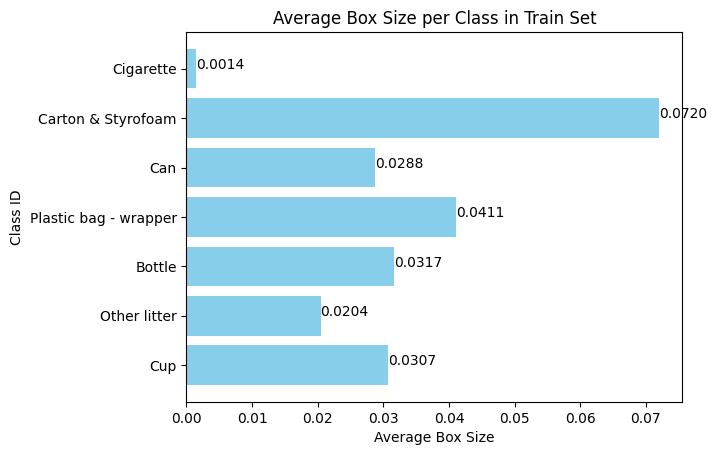

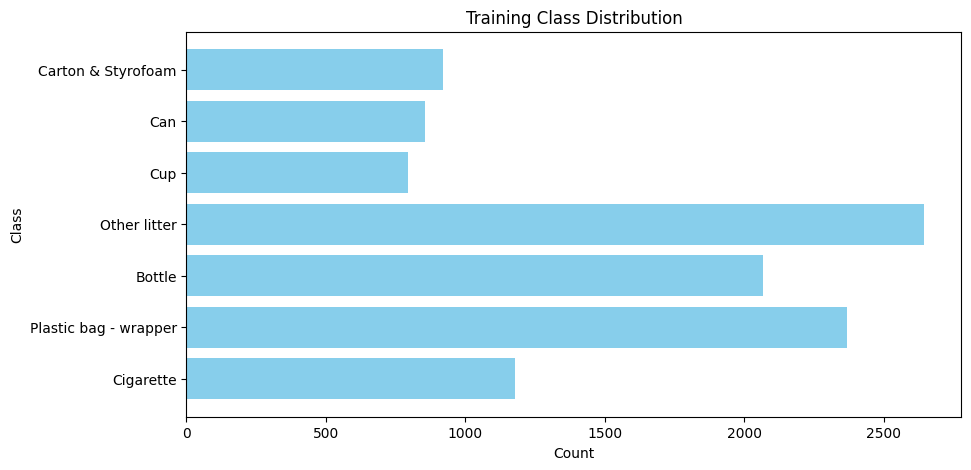

In [137]:
get_average_box_size_per_class("train")

cleaned_train_dist = new_class_dist("train")
display_dist(cleaned_train_dist, "Training")

## Addressing Overlapping Bounding Boxes: Setting the Threshold 🎯

After dealing with class imbalance and bounding box sizes, the next step was to examine the issue of overlapping bounding boxes within the dataset.

#### The Overlap Issue 🤔

Overlapping bounding boxes can create ambiguity during model training, potentially leading to decreased performance and reliability.

#### The Overlap Threshold: `iou_threshold=0.35` 📏

After careful examination, it was decided to remove bounding boxes with an Intersection over Union (IoU) greater than 0.35. This threshold was chosen based on the following considerations:

1. **Data Quality**: Removing high overlap ensures that each bounding box is a distinct and meaningful representation of an object.
  
2. **Model Clarity**: This reduces the chances of the model getting confused between overlapping instances.

3. **Computational Efficiency**: Eliminating excessive overlaps can also make the training process more efficient.

By setting this IoU threshold, the aim is to create a cleaner and more reliable dataset, thereby enhancing the model's ability to generalize and perform well on new data.



In [62]:
def get_smaller_overlapping_box(boxes, iou_threshold=0.5):
    to_remove = set()
    for i in range(len(boxes)):
        for j in range(i + 1, len(boxes)):
            class1, x1, y1, w1, h1 = boxes[i]
            class2, x2, y2, w2, h2 = boxes[j]

            if class1 != class2:
                continue

            x_overlap = max(
                0, min(x1 + w1 / 2, x2 + w2 / 2) - max(x1 - w1 / 2, x2 - w2 / 2)
            )
            y_overlap = max(
                0, min(y1 + h1 / 2, y2 + h2 / 2) - max(y1 - h1 / 2, y2 - h2 / 2)
            )

            intersection = x_overlap * y_overlap
            union = w1 * h1 + w2 * h2 - intersection

            iou = intersection / union if union > 0 else 0

            if iou > iou_threshold:
                if w1 * h1 < w2 * h2:
                    to_remove.add(i)
                else:
                    to_remove.add(j)
    return [box for i, box in enumerate(boxes) if i not in to_remove]


def get_overlapping_boxes_stats(data_type, iou_threshold=0.5):
    total_boxes = 0
    overlapping_boxes_count = 0
    label_list = []

    label_files = get_label_files(data_type)
    for label_file in label_files:
        boxes = get_boxes_from_label_file(LABEL_DICT[data_type], label_file)
        total_boxes += len(boxes)
        filtered_boxes = get_smaller_overlapping_box(boxes, iou_threshold)

        if overlapping_boxes := len(boxes) - len(filtered_boxes):
            overlapping_boxes_count += overlapping_boxes
            label_list.append(label_file)

    print(
        data_type.capitalize(),
        f"\nTotal boxes: {total_boxes}",
        f"\nOverlapping boxes (IoU > {iou_threshold}): {overlapping_boxes_count}",
        "\nPercentage of overlapping boxes: "
        f"{100 * overlapping_boxes_count / total_boxes if total_boxes > 0 else 0}%\n",
    )
    return label_list

In [72]:
overlapping_images = get_overlapping_boxes_stats("train", iou_threshold=0.30)

Train 
Total boxes: 10834 
Overlapping boxes (IoU > 0.3): 28 
Percentage of overlapping boxes: 0.2584456341148237%



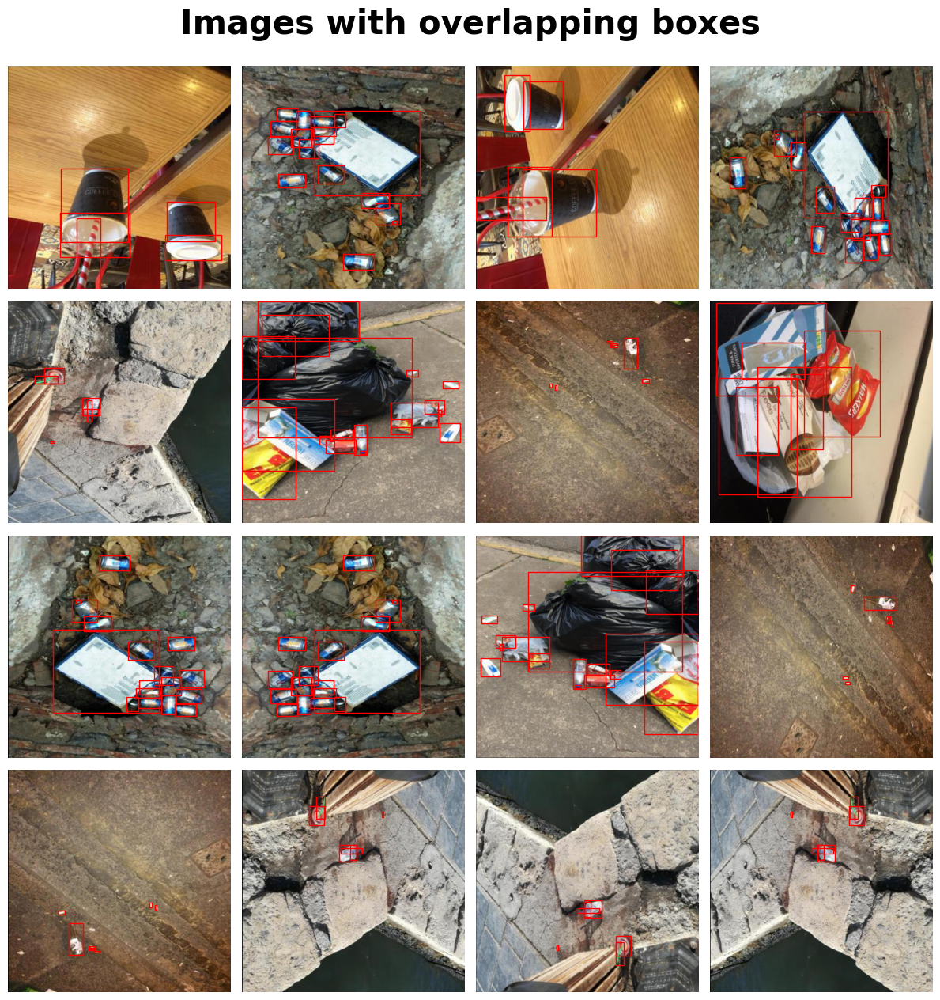

In [69]:
num_images = 4
start = random.randint(0, len(overlapping_images) - num_images**2)
display_images(
    overlapping_images[start : start + num_images**2],
    num_images,
    "Images with overlapping boxes",
)

In [132]:
def remove_overlapping_boxes(data_type, iou_threshold):
    label_files = get_label_files(data_type)

    for label_file in label_files:
        boxes = get_boxes_from_label_file(label_file, LABEL_DICT[data_type])
        filtered_boxes = get_smaller_overlapping_box(boxes, iou_threshold)

        label_path = os.path.join(DATA, LABEL_DICT[data_type], label_file)
        with open(label_path, "w") as f:
            for box in filtered_boxes:
                f.write(" ".join(map(str, box)) + "\n")

In [135]:
remove_overlapping_boxes("train", iou_threshold=0.35)
remove_overlapping_boxes("test", iou_threshold=0.35)
remove_overlapping_boxes("valid", iou_threshold=0.35)

There was only a small number of images with overlapping bounding boxes, around 25 boxes, so this step didn't have a huge impact on the dataset. However, it was still important to address this issue to ensure that the model is trained on high-quality data. 

# YOLOv8: The Next-Gen Object Detector 🚀

YOLOv8 is the latest iteration in the YOLO (You Only Look Once) series of object detection models. Known for its speed and accuracy, YOLOv8 brings several improvements and optimizations over its predecessors. In this project, YOLOv8 is configured with specific parameters to tailor its performance to the TACO dataset.


In [7]:
yolo = YOLO("yolov8x.pt")

#### Impactfull Parameters for the TACO Dataset 

 
- **Cosine Learning Rate**: Enables a cosine annealing learning rate schedule for better convergence.

- **Mosaic Augmentation: 0.8, Mixup Augmentation: 0.2**: A higher value is used for Mosaic as it effectively combines multiple images into one, thereby enriching the dataset and improving model robustness. A lower value (`0.2`) is chosen for Mixup. The reason for this is that the TACO dataset already contains many obscured objects. Applying Mixup too aggressively could make the data even more challenging to interpret, which is not ideal given the dataset's existing complexities. I let the rest of the augmentation parameters be the default values.

- **Box Loss Weight (box): 8.0, Class Loss Weight (cls): 0.5, Distribution Focal Loss (dfl): 3.0** - 
 Lowering the class loss weight allows the model to focus more on getting the bounding boxes right, rather than accurately classifying the object within the box. This is particularly useful for this dataset, where label accuracy is a concern.<br> By prioritizing box loss over class loss, the aim is to improve the model's ability to correctly identify object locations, even if the class labels are not perfectly accurate. <br>A `dfl` value of `3.0` is chosen to give moderate to strong emphasis on aligning the predicted class distributions with the actual class distributions in the dataset. This is especially beneficial for the TACO dataset.

In [6]:
params = {
    "data": YAML_PATH,
    "imgsz": 736,
    "epochs": 250,
    "optimizer": "auto",
    "pretrained": True,
    "lr0": 5e-03,
    "lrf": 1e-03,
    "cos_lr": True,
    "workers": 10,
    "save_period": -1,
    "deterministic": False,
    "warmup_epochs": 1,
    "mosaic": 0.75,
    "mixup": 0.15,
    "flipud": 0.5,
    "scale": 0.4,
    "box": 8.0,
    "cls": 1.5,
    "dfl": 3.0,
}

For more information on the training evaluation, see the file `yolo_8_results.csv`.

In [ ]:
results = yolo.train(**params)

In [91]:
ultra_path = "/notebooks/runs/detect"
best_path = os.path.join(ultra_path, "best_train", "weights", "best.pt")
ultra_model = YOLO(best_path)

In [12]:
ultra_result = ultra_model.val(split="test", data=YAML_PATH)

Ultralytics YOLOv8.0.190 🚀 Python-3.9.16 torch-2.0.1+cu117 CUDA:0 (NVIDIA RTX A6000, 48677MiB)


Model summary (fused): 268 layers, 68130309 parameters, 0 gradients, 257.4 GFLOPs
val: Scanning /notebooks/TACO-3/test/labels.cache... 902 images, 0 backgrounds, 0 corrupt: 100%|██████████| 902/902 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:16<00:00,  3.54it/s]
                   all        902       2367      0.816      0.564      0.651      0.532
             Cigarette        902        228      0.895        0.5      0.594      0.327
 Plastic bag - wrapper        902        527      0.792      0.639      0.718      0.617
                Bottle        902        445      0.793      0.589      0.671      0.541
          Other litter        902        632      0.846      0.449      0.551      0.427
                   Cup        902        160      0.827      0.631      0.726      0.654
                   Can        902        187      0.812      0.636      0.702      0.603
    Carton & Styrofoam  

### Insights

1. **High Precision**: Across the board, the model excels in precision. This is a testament to the model's ability to correctly identify objects within the bounding boxes. It aligns well with our focus on box loss during training.

2. **Variable Recall**: The recall scores are inconsistent across different classes. This suggests that while the model is good at identifying what it sees, it may not be seeing all there is to see. This is an area that could benefit from further tuning.

3. **mAP50 vs mAP50-95**: The model performs notably better when evaluated at a single IoU threshold (mAP50) compared to a range (mAP50-95). This could be indicative of the model's strength in more 'clear-cut' cases and a potential area for improvement in more ambiguous scenarios.

### Visualizing the Results: A Closer Look

In [79]:
result_df = pd.read_csv("/notebooks/runs/detect/best_train/results.csv")
result_df.columns = [c.strip() for c in result_df.columns]
result_df.drop(["lr/pg1", "lr/pg2", "epoch"], axis=1, inplace=True)
result_df.tail()

,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0
245,0.50727,0.47611,1.6647,0.75452,0.51041,0.58312,0.47692,0.93717,3.6378,2.2160,0.000019
246,0.50514,0.47818,1.6647,0.75662,0.50968,0.58310,0.47684,0.93769,3.6396,2.2159,0.000015
247,0.49996,0.47071,1.6623,0.75249,0.51136,0.58302,0.47685,0.93738,3.6424,2.2159,0.000011
248,0.50305,0.47100,1.6623,0.75162,0.51192,0.58305,0.47686,0.93758,3.6428,2.2165,0.000009
249,0.50360,0.47096,1.6625,0.75337,0.51159,0.58286,0.47716,0.93744,3.6457,2.2166,0.000007


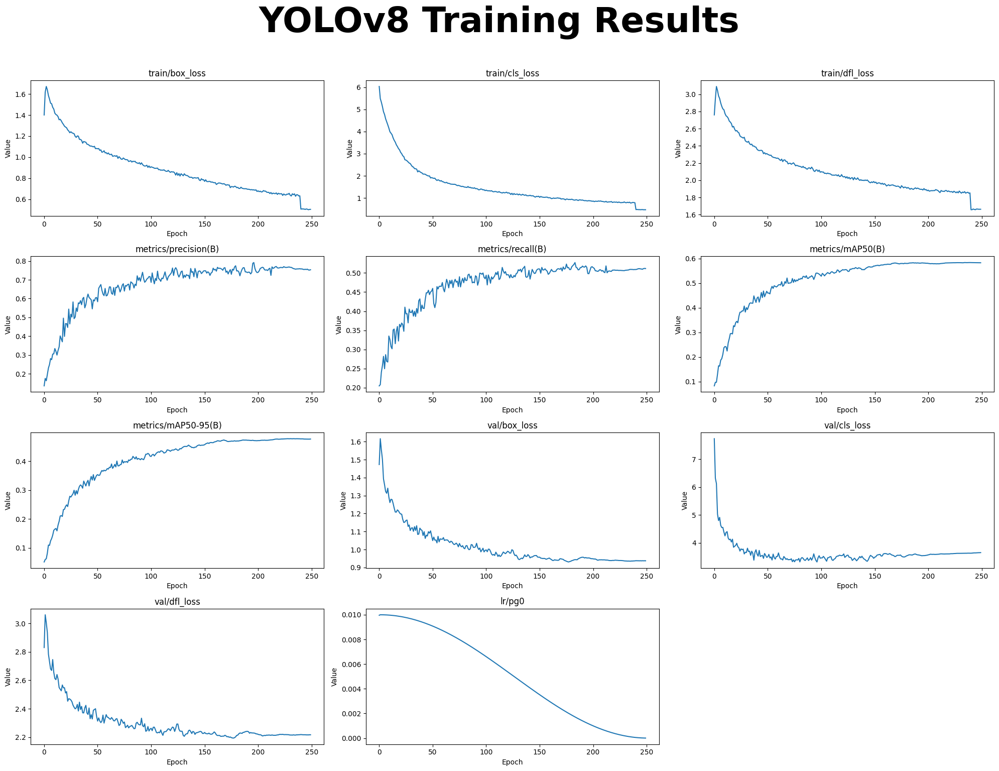

In [82]:
plot_result(result_df)

# YOLO NAS: The Architect of Object Detection 

YOLO NAS (Neural Architecture Search) is an avant-garde approach in the YOLO (You Only Look Once) family, designed to automatically find the best architecture for object detection tasks. Unlike traditional models that rely on human expertise for architecture design, YOLO NAS employs machine learning to discover optimal structures, making it a self-evolving system. For this project, YOLO NAS is fine-tuned with specific parameters to adapt its innovative architecture to the unique challenges of the TACO dataset.


In [7]:
CLASSES = [
    "Cigarette",
    "Plastic bag - wrapper",
    "Bottle",
    "Other litter",
    "Cup",
    "Can",
    "Carton & Styrofoam",
]

NUM_CLASSES = len(CLASSES)

CHECKPOINT = "/notebooks/nas-checkpoints"
EXPERIMENT_NAME = "nas-taco-new1"

DATALOADER_PARAMS = {"batch_size": 20, "num_workers": 10, "pin_memory": True}

MODEL_NAME = "yolo_nas_l"
PRETRAINED_WEIGHTS = "coco"

Yolo nas uses a trainer to handel each so called "experiment".

In [8]:
trainer = Trainer(experiment_name=EXPERIMENT_NAME, ckpt_root_dir=CHECKPOINT)

I will use the coco_detection_yolo_format for my dataloaders

In [9]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        "data_dir": DATA,
        "images_dir": TRAIN_IMAGES,
        "labels_dir": TRAIN_LABELS,
        "classes": CLASSES,
    },
    dataloader_params=DATALOADER_PARAMS,
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        "data_dir": DATA,
        "images_dir": VAL_IMAGES,
        "labels_dir": VAL_LABELS,
        "classes": CLASSES,
    },
    dataloader_params=DATALOADER_PARAMS,
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        "data_dir": DATA,
        "images_dir": TEST_IMAGES,
        "labels_dir": TEST_LABELS,
        "classes": CLASSES,
    },
    dataloader_params=DATALOADER_PARAMS,
)

[2023-10-05 11:04:03] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 4182/4182 [00:23<00:00, 176.31it/s]
[2023-10-05 11:04:27] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 897/897 [00:04<00:00, 185.20it/s]
[2023-10-05 11:04:32] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations:  97%|█████████▋| 873/902 [00:05<00:00, 131.26it/s]

Indexing dataset annotations: 100%|██████████| 902/902 [00:05<00:00, 167.27it/s]


Example of the augmentation

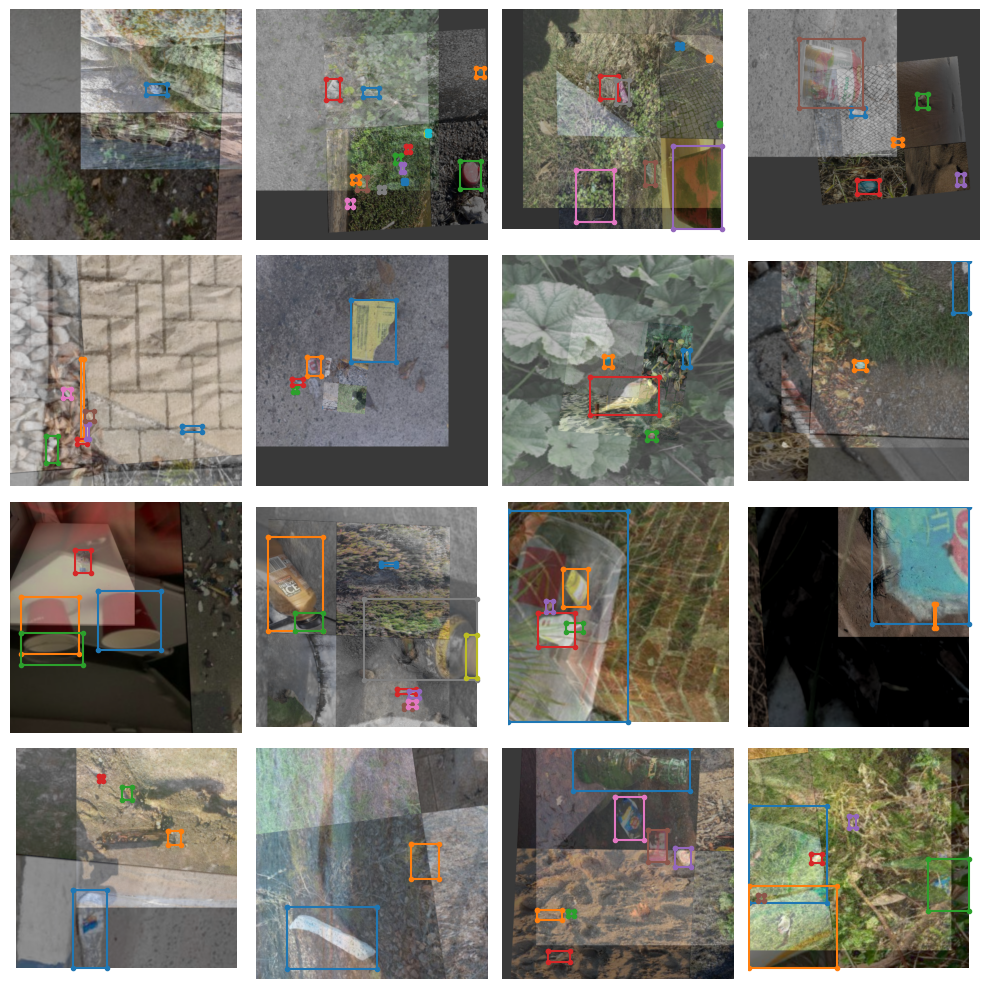

In [63]:
train_data.dataset.plot()

List of all default augmentations

In [10]:
for transform in train_data.dataset.transforms:
    title, kwargs = str(transform).split("(", 1)
    print(title)
    pprint(
        {
            k.split(":")[0]: k.split(":")[1]
            for k in kwargs.split(",")
            if len(k.split(":")) > 1
        }
    )

DetectionMosaic
{" 'border_value'": ' 114)',
 " 'enable_mosaic'": ' True',
 " 'input_dim'": ' (640',
 " 'non_empty_targets'": ' False',
 " 'prob'": ' 1.0',
 "'additional_samples_count'": ' 3'}
DetectionRandomAffine
{" 'ar_thr'": ' 20',
 " 'area_thr'": ' 0.1',
 " 'border_value'": ' 114)',
 " 'degrees'": ' 10.0',
 " 'enable'": ' True',
 " 'filter_box_candidates'": ' True',
 " 'non_empty_targets'": ' False',
 " 'scale'": ' [0.1',
 " 'shear'": ' 2.0',
 " 'target_size'": ' (640',
 " 'translate'": ' 0.1',
 " 'wh_thr'": ' 2',
 "'additional_samples_count'": ' 0'}
DetectionMixup
{" 'border_value'": ' 114)',
 " 'enable_mixup'": ' True',
 " 'flip_prob'": ' 0.5',
 " 'input_dim'": ' (640',
 " 'mixup_scale'": ' [0.5',
 " 'non_empty_targets'": ' True',
 " 'prob'": ' 1.0',
 "'additional_samples_count'": ' 1'}
DetectionHSV
{" '_additional_channels_warned'": ' False)',
 " 'bgr_channels'": ' (0',
 " 'hgain'": ' 5',
 " 'non_empty_targets'": ' False',
 " 'prob'": ' 1.0',
 " 'sgain'": ' 30',
 " 'vgain'": ' 

I've opted to use a similar approach to data augmentation as I did with the YOLOv8 model. Upon reviewing the original augmentation settings, I found them to be somewhat aggressive for this already challenging dataset. As a result, I've decided to lighten the augmentation parameters to better suit the dataset's complexities.

In [6]:
# Update DetectionMosaic
train_data.dataset.transforms[0].additional_samples_count = 3
train_data.dataset.transforms[0].prob = 0.75
train_data.dataset.transforms[0].non_empty_targets = True
train_data.dataset.transforms[0].input_dim = (736, 736)

# Update DetectionRandomAffine
train_data.dataset.transforms[1].degrees = 0
train_data.dataset.transforms[1].translate = 0.1
train_data.dataset.transforms[1].scale = [0.8, 1.4]
train_data.dataset.transforms[1].target_size = (736, 736)
train_data.dataset.transforms[1].shear = 0

# Update DetectionHSV
train_data.dataset.transforms[3].hgain = 3
train_data.dataset.transforms[3].sgain = 20
train_data.dataset.transforms[3].vgain = 20

# Update DetectionHorizontalFlip
train_data.dataset.transforms[4].prob = 0.5

# Update DetectionPaddedRescale
train_data.dataset.transforms[5].input_dim = (736, 736)

# Update DetectionMixup
train_data.dataset.transforms[2].additional_samples_count = 1
train_data.dataset.transforms[2].prob = 0.15
train_data.dataset.transforms[2].input_dim = (736, 736)
train_data.dataset.transforms[2].mixup_scale = [0.4, 0.6]

# Update DetectionPaddedRescale
train_data.dataset.transforms[6].input_dim = (736, 736)
train_data.dataset.transforms[6].pad_value = 0

Data with new augmentations

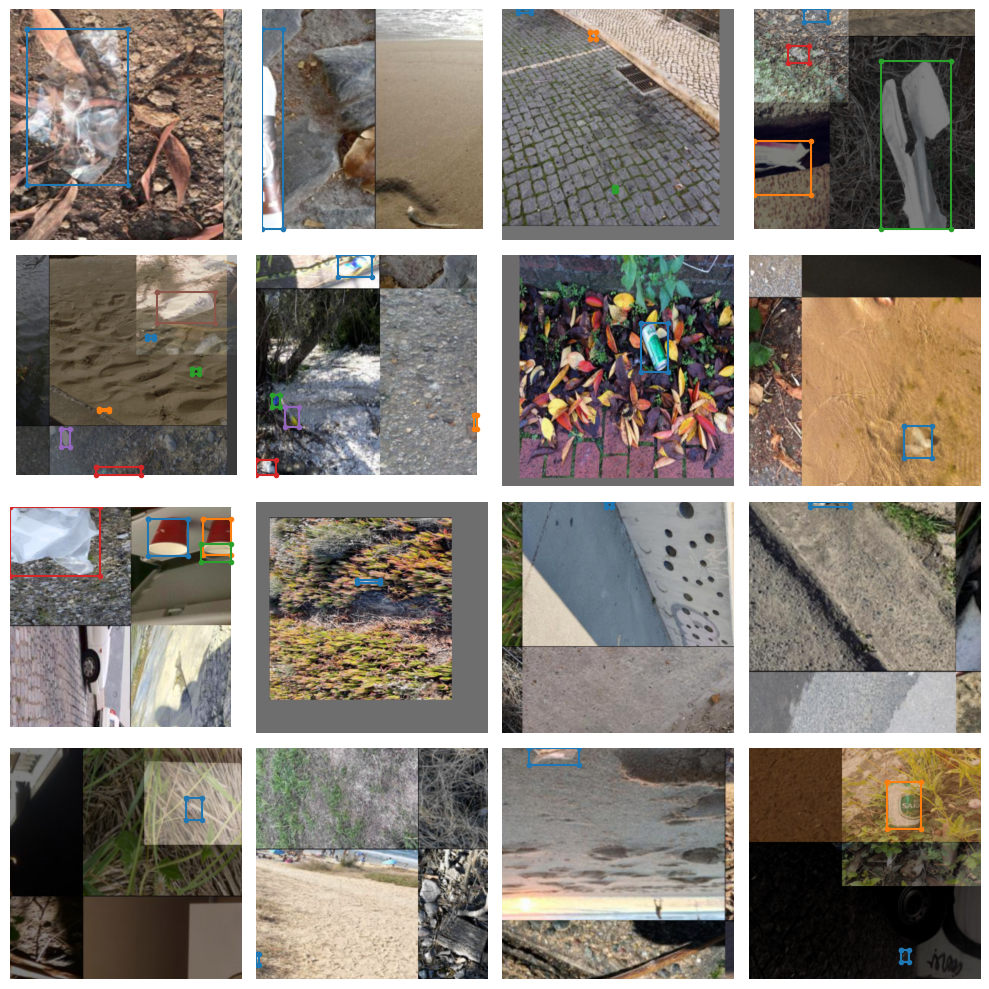

In [15]:
train_data.dataset.plot()

In [7]:
nas_model = models.get(
    MODEL_NAME,
    num_classes=NUM_CLASSES,
    pretrained_weights=PRETRAINED_WEIGHTS,
)

[2023-10-01 22:09:27] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
[2023-10-01 22:09:28] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_l


In [17]:
train_params = {
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-5,
    "lr_warmup_epochs": 10,
    "initial_lr": 1e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.025,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 5e-05},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "exp", "beta": 15},
    "max_epochs": 250,,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=NUM_CLASSES,
        reg_max=16,
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=NUM_CLASSES,
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7,
            ),
        )
    ],
    # "run_validation_freq": 2,
    # "run_test_freq": 5,
    "metric_to_watch": "mAP@0.50",
    # "silent_mode": True,
}

When training YOLO with Neural Architecture Search (NAS), enabling Exponential Moving Averages (EMA) with a decay factor of 0.9, exponential decay type, and a beta value of 15 can offer significant benefits. EMA helps in stabilizing the training process by reducing parameter noise and smoothing out variations, leading to faster convergence and improved generalization on unseen data. These settings act as a form of implicit regularization, making the model more robust and effective. This would improve the training results compared to not using EMA.

For more information on the training evaluation, see the file `yolo_nas_results.txt`.

In [ ]:
trainer.train(
    model=nas_model,
    training_params=train_params,
    train_loader=train_data,
    valid_loader=val_data,
)

Load the model

In [14]:
nas_model = models.get(
    MODEL_NAME,
    num_classes=NUM_CLASSES,
    checkpoint_path=os.path.join(CHECKPOINT, EXPERIMENT_NAME, "average_model.pth"),
)

[2023-10-02 19:36:49] INFO - checkpoint_utils.py - Successfully loaded model weights from /notebooks/nas-checkpoints/nas-taco-new1/average_model.pth EMA checkpoint.


In [37]:
trainer.test(
    model=nas_model,
    test_loader=test_data)

Testing: 100%|██████████| 56/56 [00:14<00:00,  3.93it/s]


{'Precision@0.50': 0.15560472011566162,
 'Recall@0.50': 0.6664692163467407,
 'mAP@0.50': 0.5662480592727661,
 'F1@0.50': 0.25143948197364807}

This was the best score I got with YOLO NAS after trying different parameters such as batch size, learning rate, ema, and different augmentations. The result is not as good as YOLOv8, but there as still some parameters that could be tweaked to improve the results, such as loss, valid_metrics_list and more.

The metrics suggest that YOLO NAS has a high recall but suffers from low precision. This could make it suitable for applications where missing a true positive would be more detrimental than getting some false positives. However, the low F1 score and moderate mAP indicate that there is substantial room for improvement. Fine-tuning the model parameters could potentially lead to a more balanced and effective object detection system.

The focus on mAP during training likely skewed YOLO NAS's performance, contributing to a low F1 score. It's worth noting that the current NAS model setup allows for optimizing only one metric at a time during training. Future iterations could benefit from a more holistic evaluation approach, even if the training phase is constrained to a single metric. This would enable a more balanced and nuanced understanding of the model's capabilities.

In [17]:
def get_nas_training_data(file_path):
    lines = []
    start_reading = False
    with open(file_path, "r") as file:
        for line in file:
            if "------- config parameters end --------" in line:
                start_reading = True
                continue  
            
            if start_reading:
                if line.startswith("Epoch"):
                    lines.append(line.strip()) 
    return lines                    

In [ ]:
log_path = "experiment_logs_Oct01_10_14_11.txt"
file_path = os.path.join(CHECKPOINT, EXPERIMENT_NAME, log_path)
training_data = get_nas_training_data(file_path)

In [53]:
def parse_nas_metrics(lines):
    df_rows = []
    columns = []
    curr_epoch_metrics = {}

    for line in lines:
        metrics = line.split("\t")

        for metric in metrics[1:]:
            key, value = metric.split(": ")
            curr_epoch_metrics[key] = float(value)

        if "LR/Param_group_1" in curr_epoch_metrics:
            if not columns:
                columns.extend(sorted(curr_epoch_metrics.keys()))
            df_rows.append([curr_epoch_metrics[key] for key in columns])
            curr_epoch_metrics = {}

    return pd.DataFrame(df_rows, columns=columns)

In [74]:
nas_result_df = parse_nas_metrics(training_data)
display(nas_result_df.head())
nas_result_df.shape

,LR/Param_group_1,Train_PPYoloELoss/loss,Train_PPYoloELoss/loss_cls,Train_PPYoloELoss/loss_dfl,Train_PPYoloELoss/loss_iou,Valid_F1@0.50,Valid_PPYoloELoss/loss,Valid_PPYoloELoss/loss_cls,Valid_PPYoloELoss/loss_dfl,Valid_PPYoloELoss/loss_iou,Valid_Precision@0.50,Valid_Recall@0.50,Valid_mAP@0.50
0,0.000010,2.884181,1.913159,1.011607,0.186087,0.046638,2.346216,1.511063,0.857767,0.162508,0.024421,0.529057,0.096753
1,0.000019,2.300629,1.426519,0.912317,0.167181,0.046743,2.152419,1.379373,0.795377,0.150143,0.024302,0.645688,0.161717
2,0.000028,2.157440,1.313960,0.878459,0.161700,0.042904,2.103566,1.328403,0.803402,0.149385,0.022173,0.692119,0.202127
3,0.000037,2.060504,1.240580,0.857884,0.156393,0.046868,2.232528,1.460341,0.796827,0.149509,0.024485,0.707863,0.201755
4,0.000046,2.022086,1.202837,0.859105,0.155879,0.082674,2.048605,1.282597,0.796522,0.147099,0.044325,0.670016,0.261106


(187, 13)

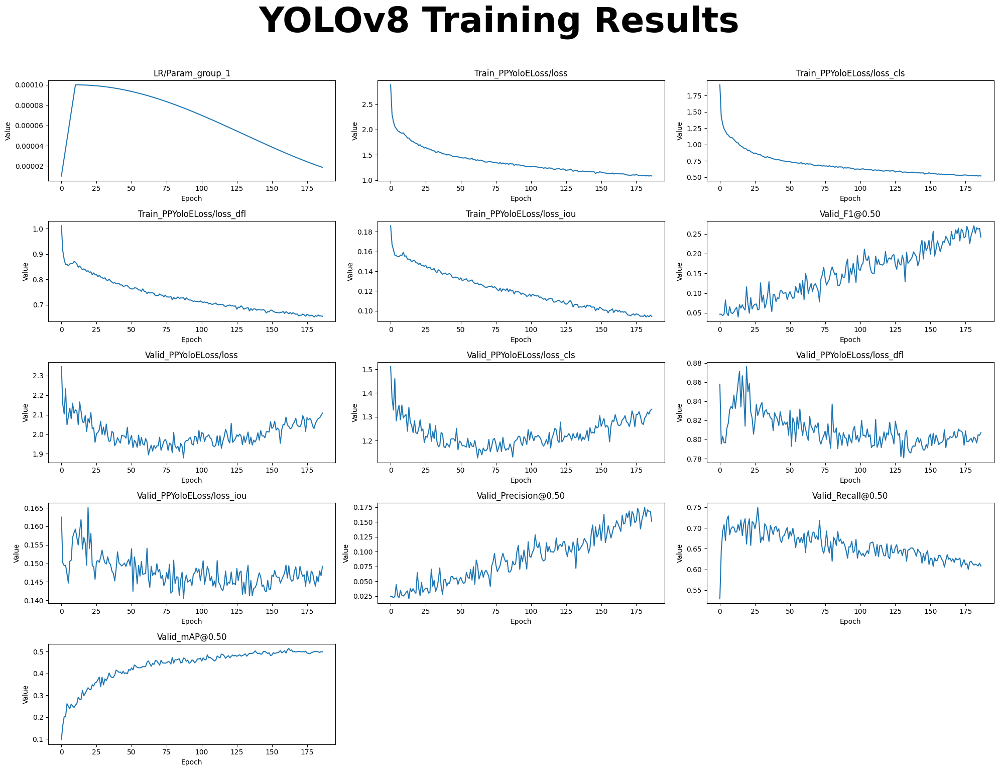

In [78]:
plot_result(nas_result_df)

# Visualizations

The visualizations reveal that while the models may not achieve perfect accuracy, they demonstrate a commendable ability to detect a majority of the objects. This suggests not only effective learning but also a promising degree of generalization, which is crucial for real-world applications.

In [29]:
supervision_test_data = sv.DetectionDataset.from_yolo(
    images_directory_path=os.path.join(DATA, TEST_IMAGES),
    annotations_directory_path=os.path.join(DATA, TEST_LABELS),
    data_yaml_path=YAML_PATH,
    force_masks=False,
)

In [94]:
def get_predictions_from_nas(dataset, model, conf=0.5, iou=0.2):
    predictions = {}

    for image_name, image in dataset:
        result = list(model.predict(image, conf=conf, iou=iou))[0]
        detections = sv.Detections(
            xyxy=result.prediction.bboxes_xyxy,
            confidence=result.prediction.confidence,
            class_id=result.prediction.labels.astype(int),
        )
        predictions[image_name] = detections
    return predictions


def get_predictions_from_ultra(dataset, model, conf=0.5, iou=0.2):
    predictions = {}

    for image_name, image in dataset:
        result = list(model.predict(source=image, conf=conf, iou=iou))[0]
        detections = sv.Detections(
            xyxy=result.boxes.xyxy.cpu().numpy(),
            confidence=result.boxes.conf.cpu().numpy(),
            class_id=result.boxes.cls.cpu().numpy().astype(int),
        )
        predictions[image_name] = detections
    return predictions

In [95]:
def prepare_images_pred_frames(keys, predictions, id_to_label, box_annotator):
    images, titles = [], []

    def annotate_and_append(key, annotation, label_type):
        frame = supervision_test_data.images[key].copy()
        labels = [id_to_label[id] for id in annotation.class_id]
        annotated_frame = box_annotator.annotate(
            scene=frame, detections=annotation, labels=labels
        )
        images.append(annotated_frame)
        titles.append(label_type)

    for key in keys:
        current_ann = supervision_test_data.annotations[key]
        annotate_and_append(key, current_ann, "annotations")

        current_pred = predictions[key]
        annotate_and_append(key, current_pred, "predictions")

    return images, titles


def display_predictions(keys, predictions, num_display=5, id_to_label=CLASSES):
    box_annotator = sv.BoxAnnotator(thickness=5)
    images, titles = prepare_images_pred_frames(
        keys=keys,
        predictions=predictions,
        id_to_label=id_to_label,
        box_annotator=box_annotator,
    )

    sv.plot_images_grid(
        images=images,
        titles=titles,
        grid_size=(num_display, 2),
        size=(2 * 4, num_display * 4),
    )

In [ ]:
num_display = 10
with set_seed():
    samples = random.sample(os.listdir(os.path.join(DATA, TEST_IMAGES)), 10)
    dataset_sample = [os.path.join(DATA, TEST_IMAGES, image) for image in samples]

ultra_preds = get_predictions_from_ultra(dataset=dataset_sample, model=ultra_model)
nas_preds = get_predictions_from_nas(dataset=dataset_sample, model=nas_model)

Ultra


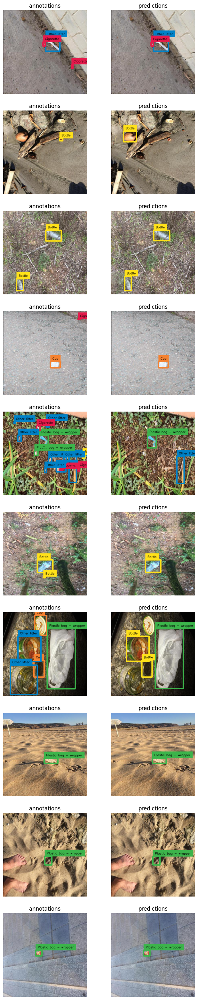

NAS


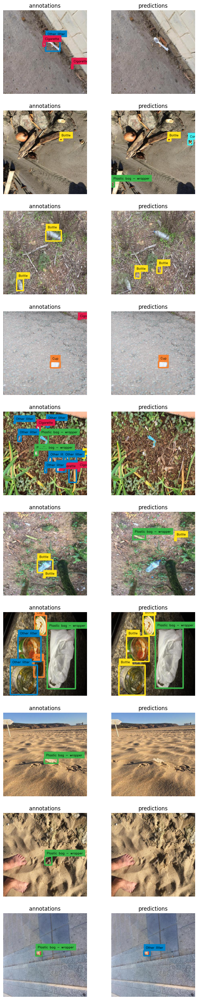

In [103]:
print("Ultra")
display_predictions(
    keys=dataset_sample,
    predictions=ultra_preds,
    num_display=num_display,
)

print("NAS")
display_predictions(
    keys=dataset_sample,
    predictions=nas_preds,
    num_display=num_display,
)